# Data Preparation

### Data Description

### Importing Packages

### Here, we import the necessary Packages

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
from keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from keras.layers import Dense, Conv2D, Flatten, Reshape, Conv2DTranspose
from keras.layers import LeakyReLU, Dropout
import matplotlib.pyplot as plt
from tensorflow.keras.utils import plot_model
from keras.preprocessing.image import ImageDataGenerator
from keras.models import load_model
from os import listdir
import cv2
import numpy as np

from numpy import zeros
from numpy import ones
from numpy.random import randn
from numpy.random import randint
from keras.datasets.cifar10 import load_data
from tensorflow.keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout

from matplotlib import pyplot as plt

from numpy import zeros
from numpy import ones
from numpy.random import randn
from numpy.random import randint
from keras.datasets.cifar10 import load_data
from tensorflow.keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout

from matplotlib import pyplot as plt

In [ ]:
def load_images(directory,n):
  images=[]
  i=0
  for file in listdir(directory):
    filename = directory + file
    image = cv2.imread(filename)
    image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    image = np.asarray(image)
    images.append(image)
    i +=1
    if i >= n:
      break
  return np.asarray(images)

In [ ]:
images=load_images('/content/drive/MyDrive/Construction_site_v6/dataset/images/train/',25)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  del sys.path[0]


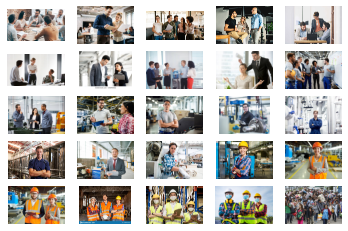

In [ ]:
for i in range(25):
  plt.subplot(5,5,1+i)
  plt.axis('off')
  plt.imshow(images[i])
plt.show()

In [ ]:
cd /content/drive/MyDrive/Construction_site_v6

/content/drive/MyDrive/Construction_site_v6


In [ ]:
pwd

'/content/drive/MyDrive/Construction_site_v6'

In [ ]:
!git clone https://github.com/meituan/YOLOv6

fatal: destination path 'YOLOv6' already exists and is not an empty directory.


In [ ]:
cd YOLOv6

/content/drive/MyDrive/Construction_site_v6/YOLOv6


In [ ]:
!pip install -r requirements.txt
# AssertionError: Torch not compiled with CUDA enabled

# This requirement file is not installing torch with cuda. So if you want to train your model using gpu then install torch with cuda

# Below torch version works with rtx 3090 (cuda 11.1)
!pip install torch==1.8.1+cu111 torchvision==0.9.1+cu111 torchaudio==0.8.1 -f https://download.pytorch.org/whl/torch_stable.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 31.0 MB/s 
     |████████████████████████████████| 13.1 MB 47.0 MB/s 
     |████████████████████████████████| 2.0 MB 58.8 MB/s 
     |████████████████████████████████| 5.2 MB 61.5 MB/s 
     |████████████████████████████████| 235 kB 74.5 MB/s 
     |████████████████████████████████| 51 kB 6.9 MB/s 
  Created wheel for onnx-simplifier: filename=onnx_simplifier-0.4.0-py3-none-any.whl size=5517 sha256=d0454b7e0bd78b1e27476e7be9a973de6c736a659467a544cb5d520d3cfb92d2
  Stored in directory: /root/.cache/pip/wheels/8f/84/39/313ce4271541dd19913100bc364076613cb9029dcf8bd7fe5b
Successfully built onnx-simplifier
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simpl

In [ ]:
import torch
torch.cuda.is_available() 
torch.cuda.get_device_name(0)

'Tesla T4'

In [ ]:
!unzip "/content/drive/MyDrive/Construction_site_v6/dataset.zip" -d "/content/drive/MyDrive/Construction_site_v6"

Archive:  /content/drive/MyDrive/Construction_site_v6/dataset.zip
   creating: /content/drive/MyDrive/Construction_site_v6/dataset/
   creating: /content/drive/MyDrive/Construction_site_v6/dataset/images/
   creating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1001.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1002.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1003.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1004.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1005.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1006.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1007.jpg  
  inflating: /content/drive/MyDrive/Construction_site_v6/dataset/images/train/1008.jpg  
  in

In [ ]:
pwd

'/content/drive/MyDrive/Construction_site_v6/YOLOv6'

In [ ]:
!python tools/train.py --batch 16 --conf configs/yolov6s_finetune.py --data data/dataset.yaml --device 0 --epochs 50 --eval-interval 2


Using 1 GPU for training... 
training args are: Namespace(batch_size=16, check_images=False, check_labels=False, conf_file='configs/yolov6s_finetune.py', data_path='data/dataset.yaml', device='0', dist_url='env://', epochs=50, eval_final_only=False, eval_interval=2, gpu_count=0, heavy_eval_range=50, img_size=640, local_rank=-1, name='exp', output_dir='./runs/train', rank=-1, resume=False, save_dir='runs/train/exp7', workers=8, world_size=1)

Train: Final numbers of valid images: 1719/ labels: 1719. 
0.1s for dataset initialization.
Convert to COCO format
100% 298/298 [00:00<00:00, 67925.80it/s]
Convert to COCO format finished. Resutls saved in /content/drive/MyDrive/Construction_site_v6/dataset/annotations/instances_val.json
Val: Final numbers of valid images: 298/ labels: 298. 
0.2s for dataset initialization.
Loading state_dict from ./weights/yolov6s.pt for fine-tuning...
Model: Model(
  (backbone): EfficientRep(
    (stem): RepVGGBlock(
      (nonlinearity): ReLU(inplace=True)
     

In [ ]:
!python tools/eval.py --data data/dataset.yaml  --weights runs/train/exp7/weights/best_ckpt.pt --device 0

Namespace(batch_size=32, conf_thres=0.001, data='data/dataset.yaml', device='0', half=False, img_size=640, iou_thres=0.65, name='exp', save_dir='runs/val/', task='val', weights='runs/train/exp7/weights/best_ckpt.pt')
Loading checkpoint from runs/train/exp7/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
Model Summary: Params: 17.19M, Gflops: 44.08
Val: Checking formats of labels with 2 process(es): 
298 label(s) found, 0 label(s) missing, 0 label(s) empty, 0 invalid label files: 100% 298/298 [00:00<00:00, 695.29it/s]
Convert to COCO format
100% 298/298 [00:00<00:00, 47075.54it/s]
Convert to COCO format finished. Resutls saved in /content/drive/MyDrive/Construction_site_v6/dataset/annotations/instances_val.json
Val: Final numbers of valid images: 298/ labels: 298. 
0.7s for dataset initialization.
Inferencing model in val datasets.: 100% 10/10 [00:07<00:00,  1.40it/s]

Evaluating speed.
Average pre-process time: 0.20 ms
Average inference time: 7.43 ms
Average NMS 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train

In [ ]:
#cd YOLOv6
!python tools/infer.py --weights runs/train/exp7/weights/best_ckpt.pt --source /content/drive/MyDrive/Construction_site_v6/dataset/images/val --yaml data/dataset.yaml --device 0 

Namespace(agnostic_nms=False, classes=None, conf_thres=0.25, device='0', half=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, max_det=1000, name='exp', project='runs/inference', save_img=True, save_txt=False, source='/content/drive/MyDrive/Construction_site_v6/dataset/images/val', weights='runs/train/exp7/weights/best_ckpt.pt', yaml='data/dataset.yaml')
Save directory already existed
Loading checkpoint from runs/train/exp7/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
100% 300/300 [03:59<00:00,  1.25it/s]
Results saved to runs/inference/exp


In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import os
import pandas as pd
import random
from skimage import io
from skimage import color
from skimage.color import rgb2gray

from skimage import data, exposure, img_as_float
from imutils import paths

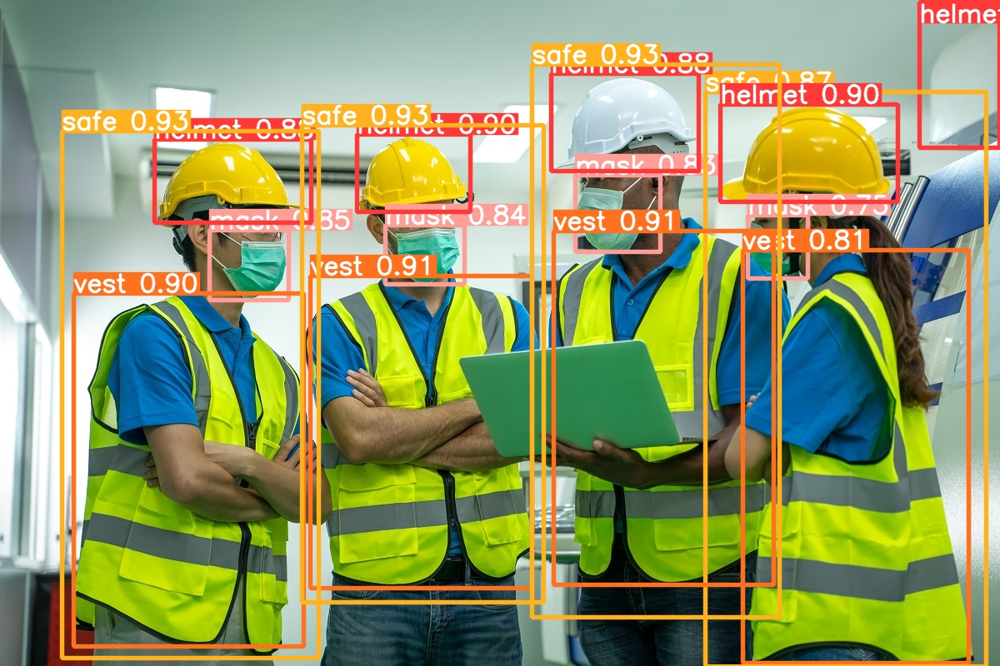

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/63.jpg', width=1000)

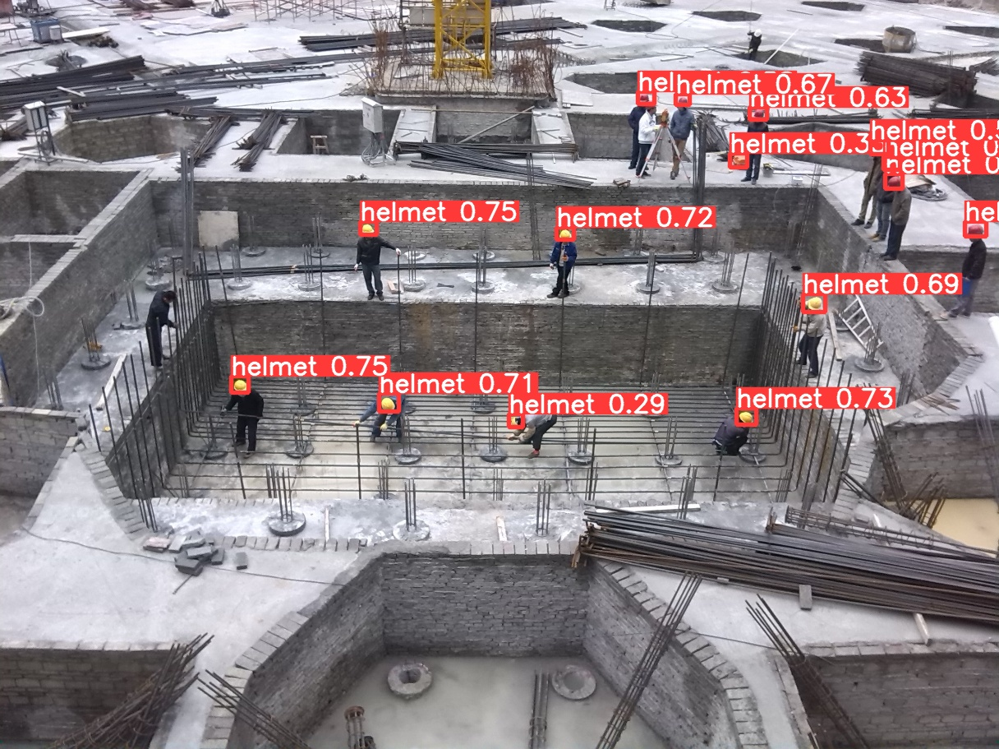

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(631).jpg', width=1000)


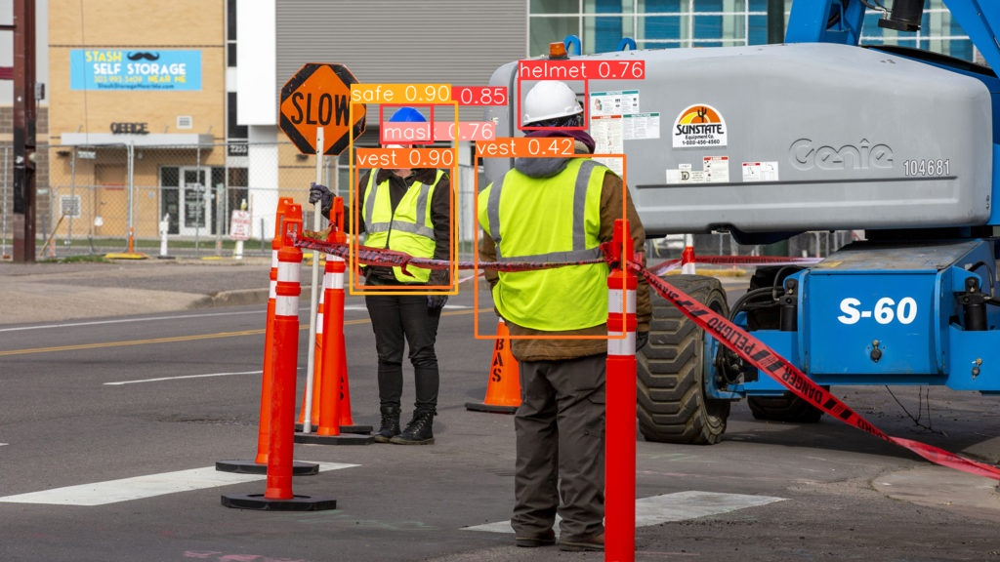

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/73.jpg', width=1000)

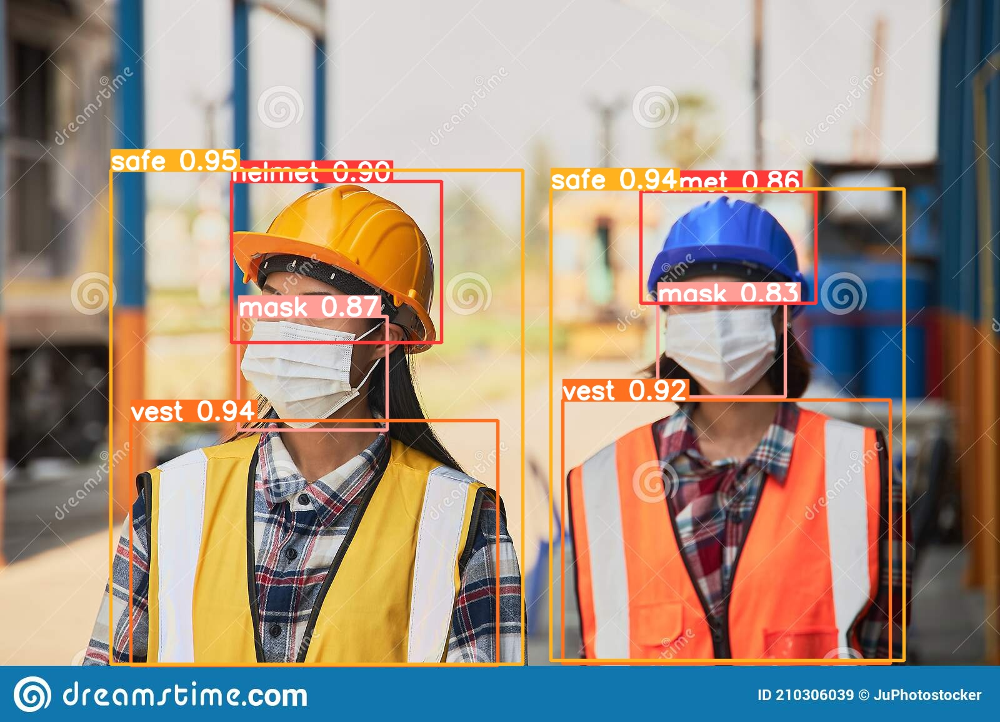

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/101.jpg', width=1000)

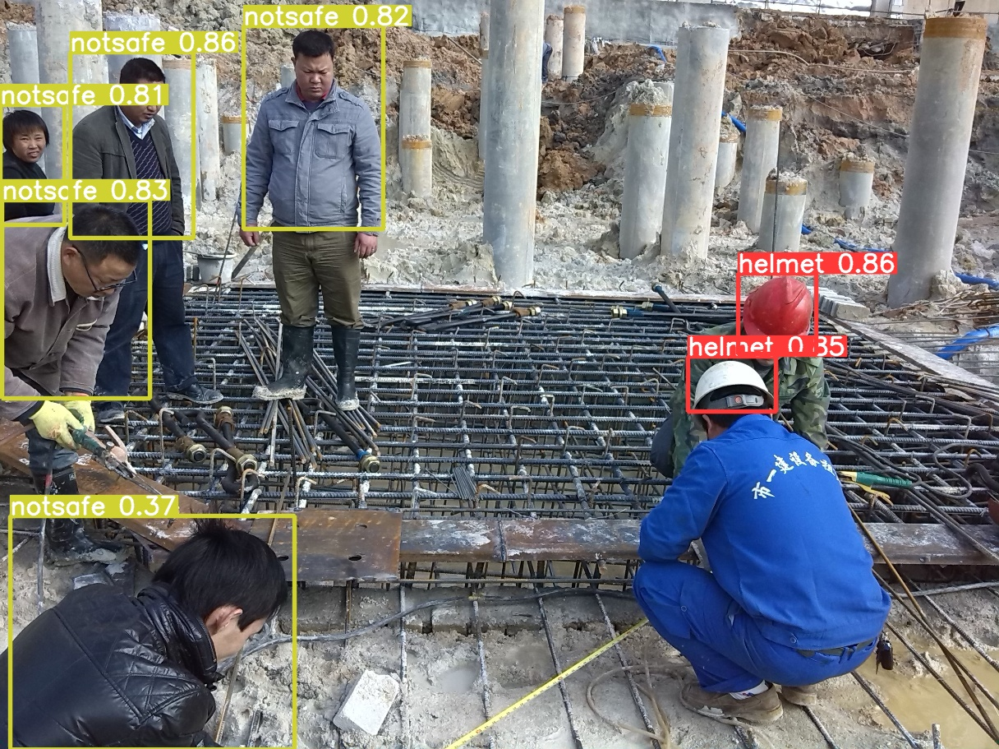

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(341).jpg', width=1000)


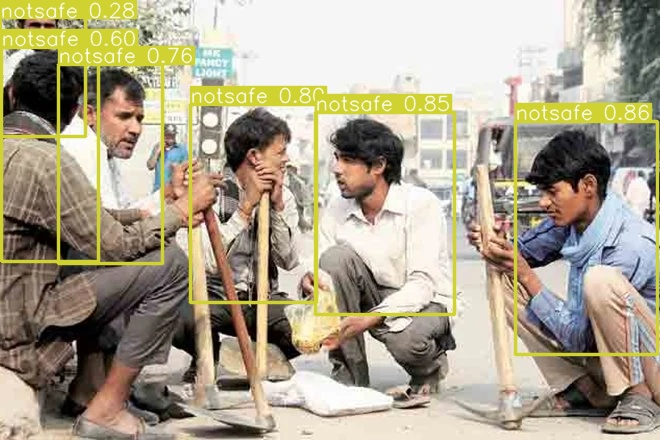

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/1100.jpg', width=1000)

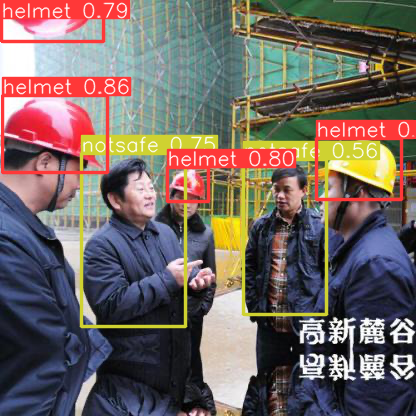

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers858.png', width=1000)

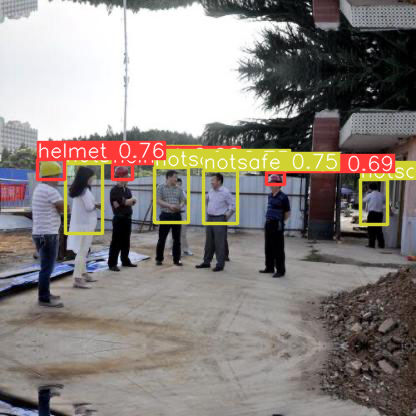

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers3568.png', width=1000)

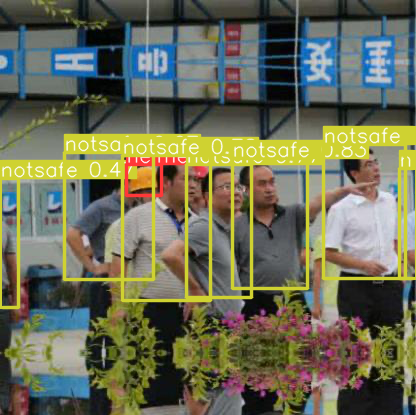

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers3914.png', width=1000)

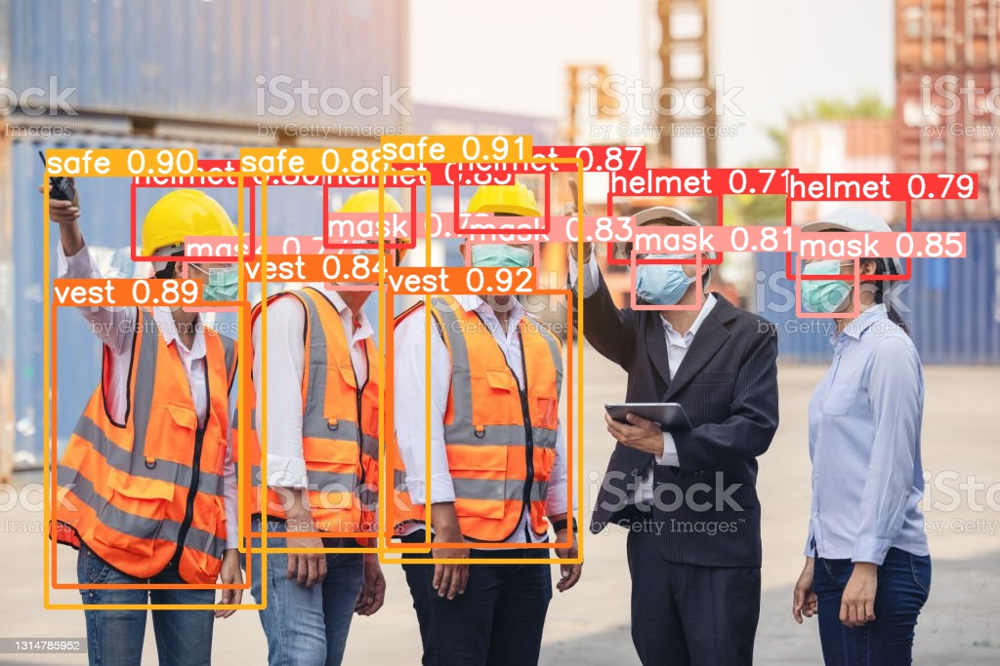

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/32.jpg', width=1000)

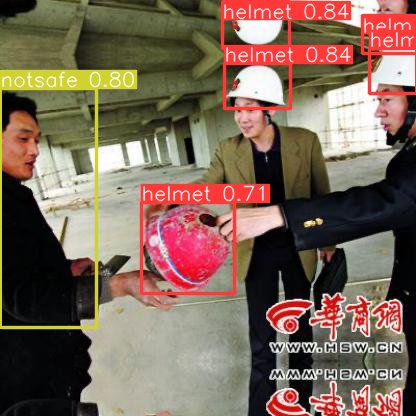

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers4770.png', width=1000)

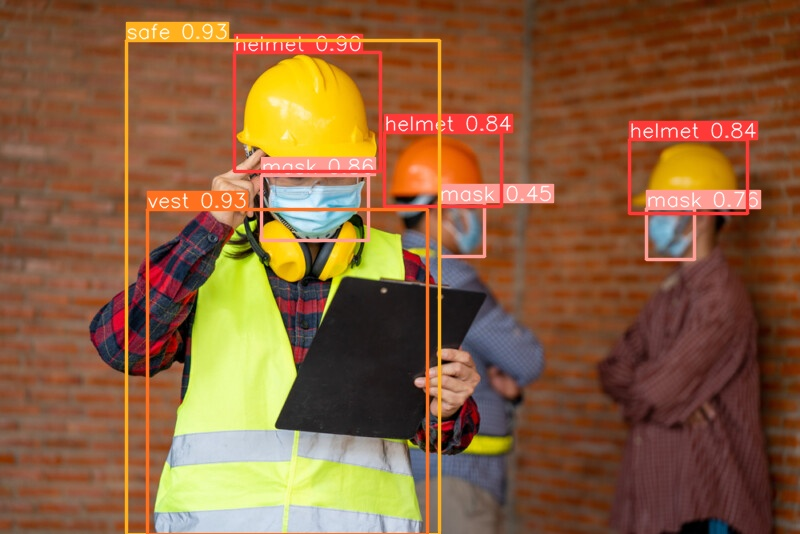

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/51.jpg', width=1000)

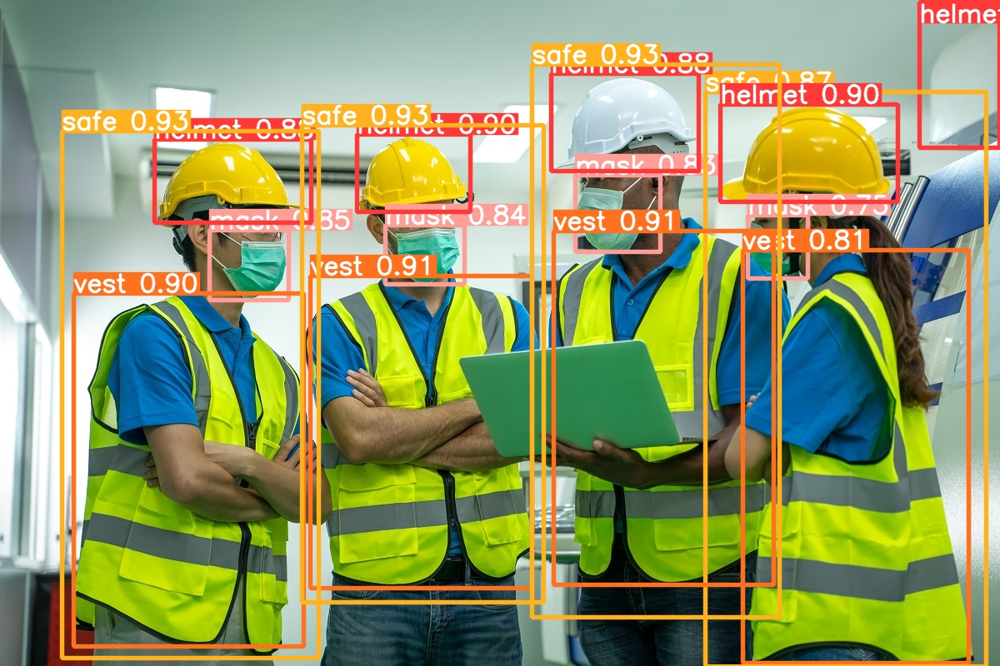

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/63.jpg', width=1000)

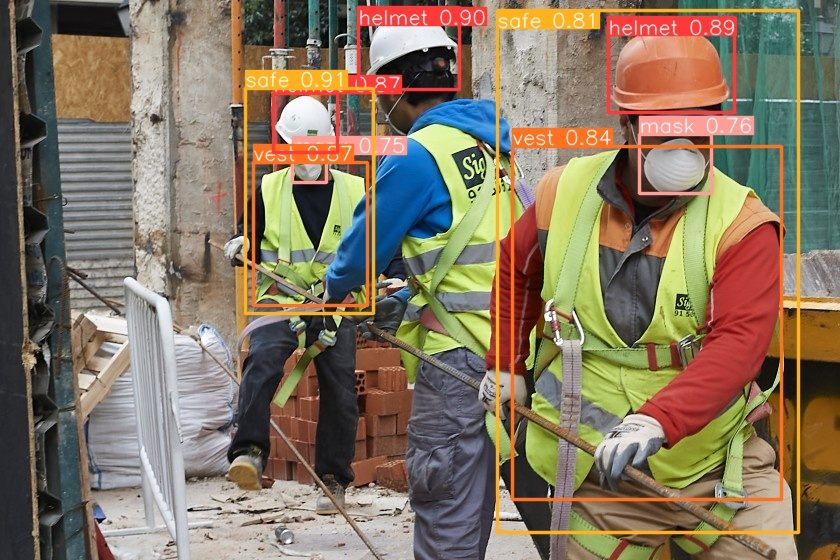

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/22.jpg', width=1000)

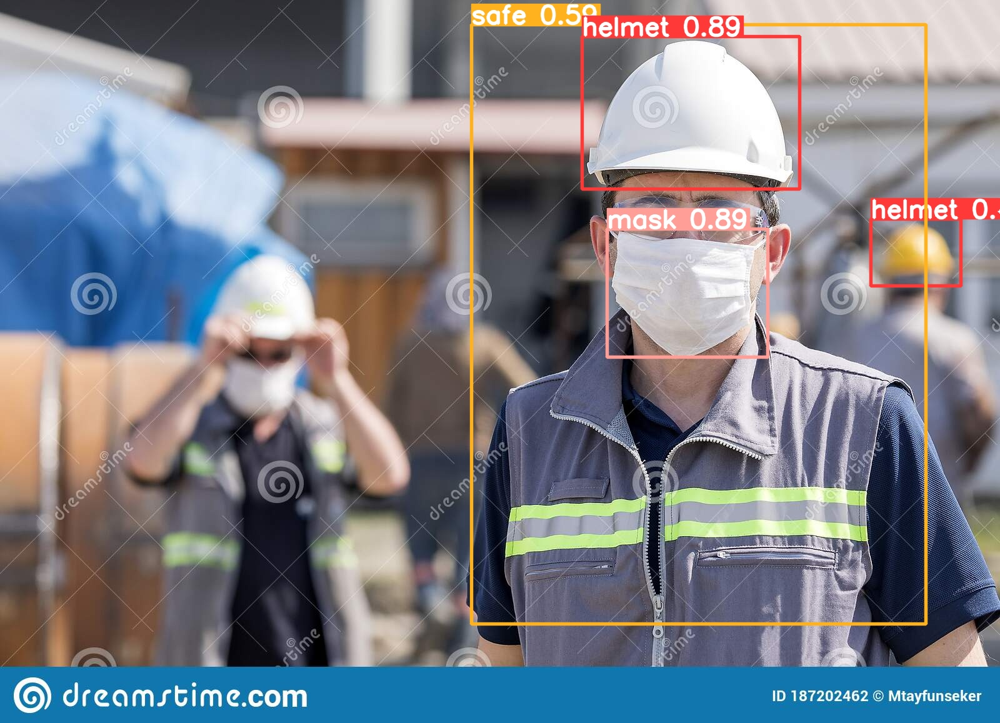

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/2.jpg', width=1000)

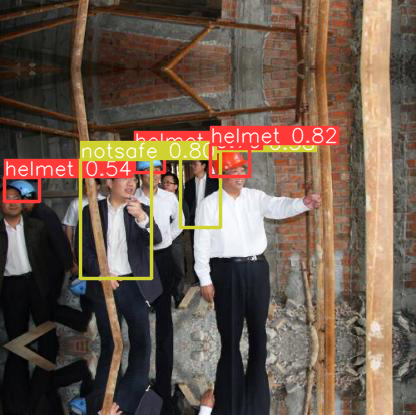

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers4607.png', width=1000)

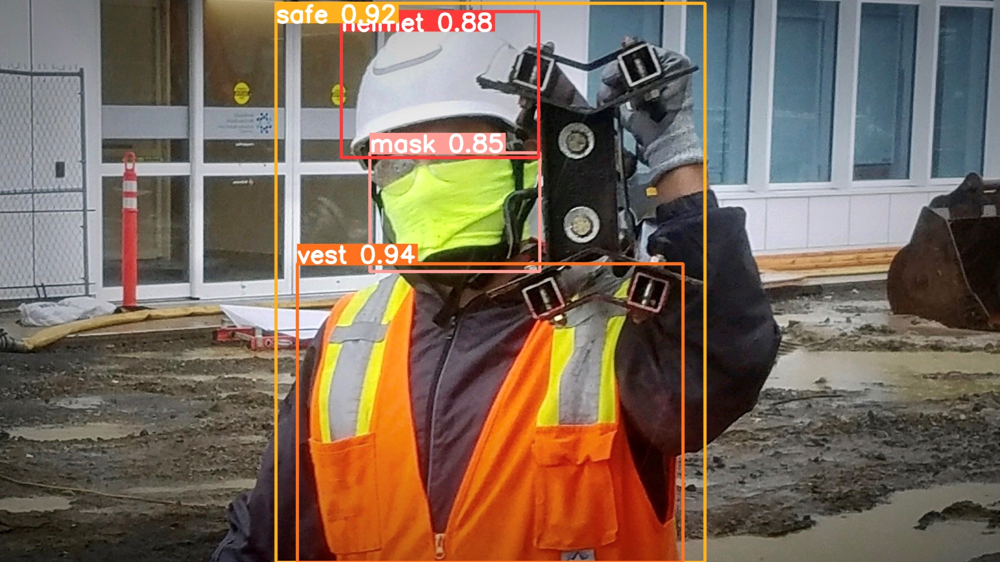

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/11.jpg', width=1000)

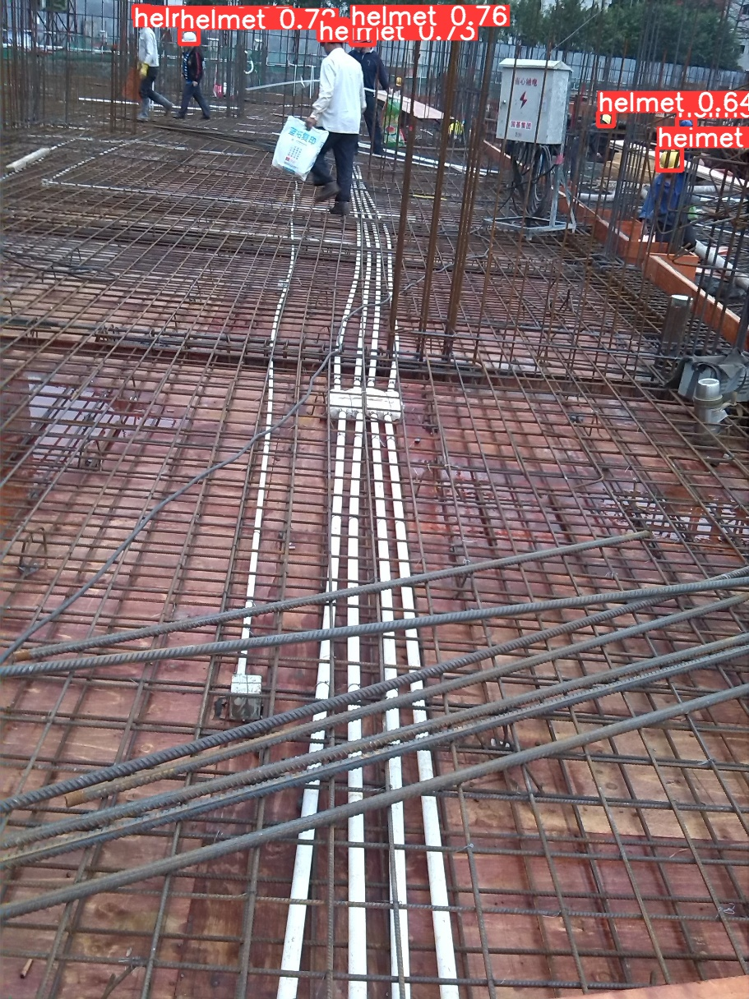

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(935).jpg', width=1000)


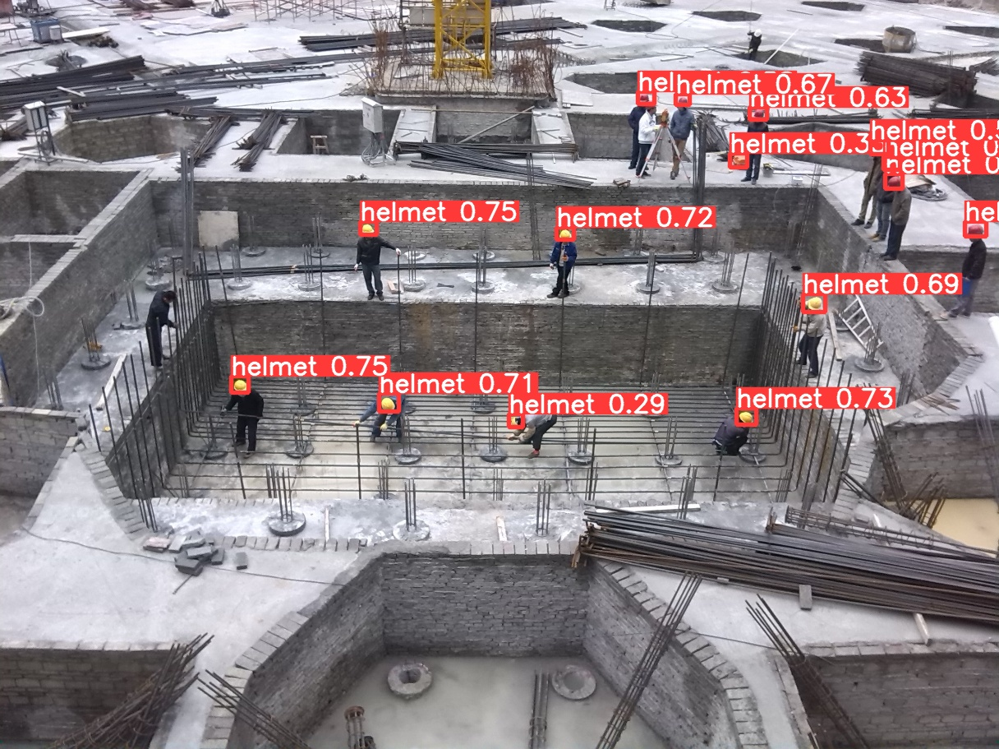

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(631).jpg', width=1000)


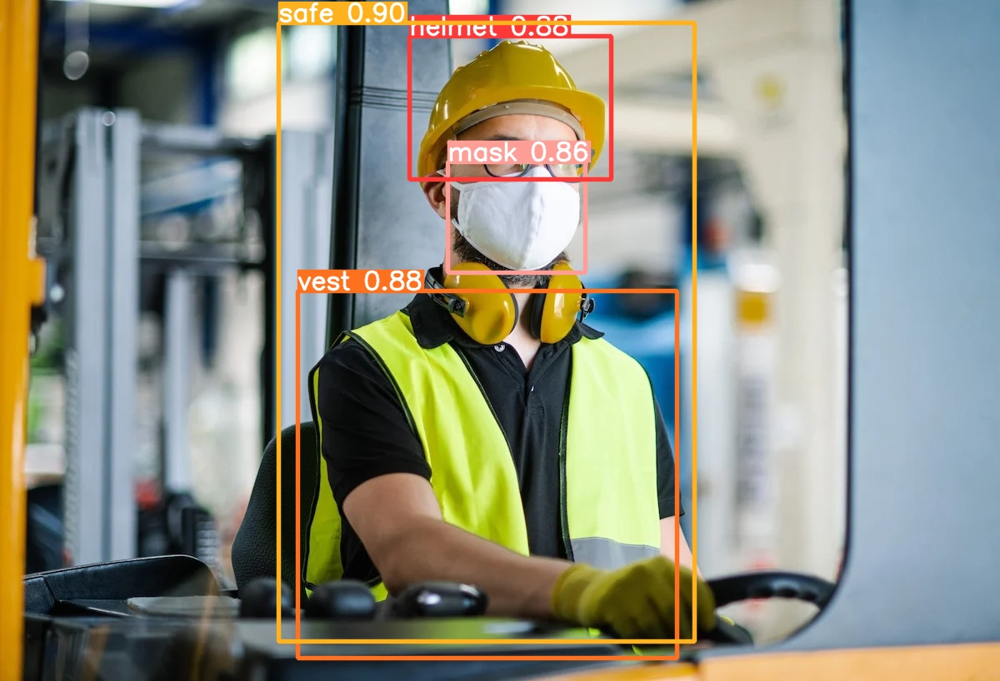

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/96.jpeg', width=1000)


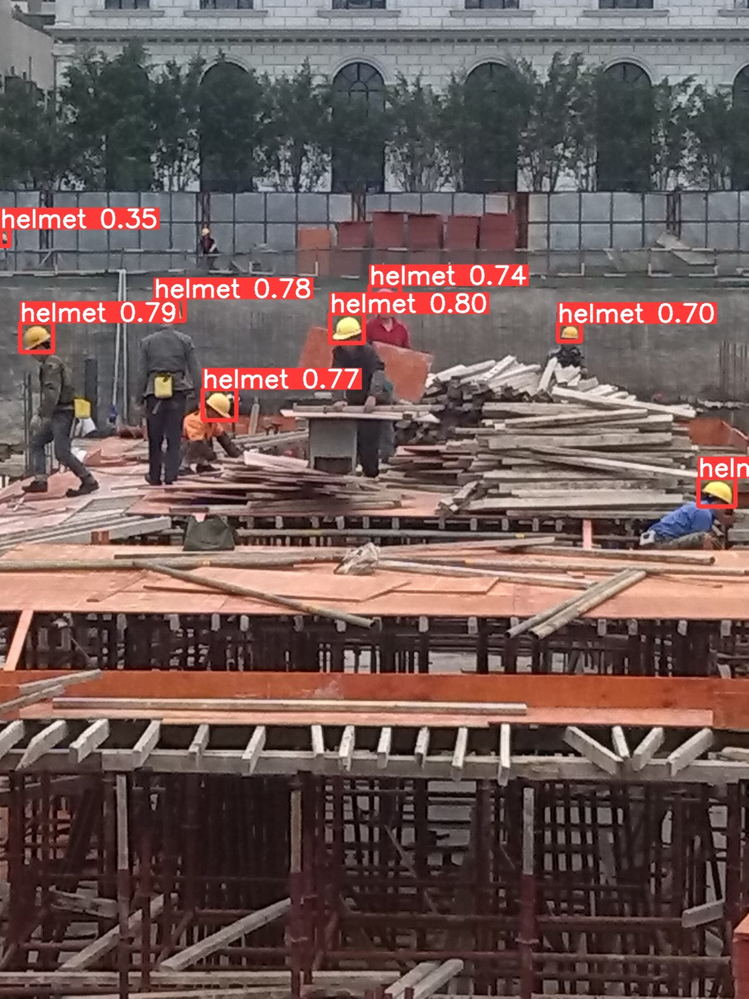

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(754).jpg', width=1000)


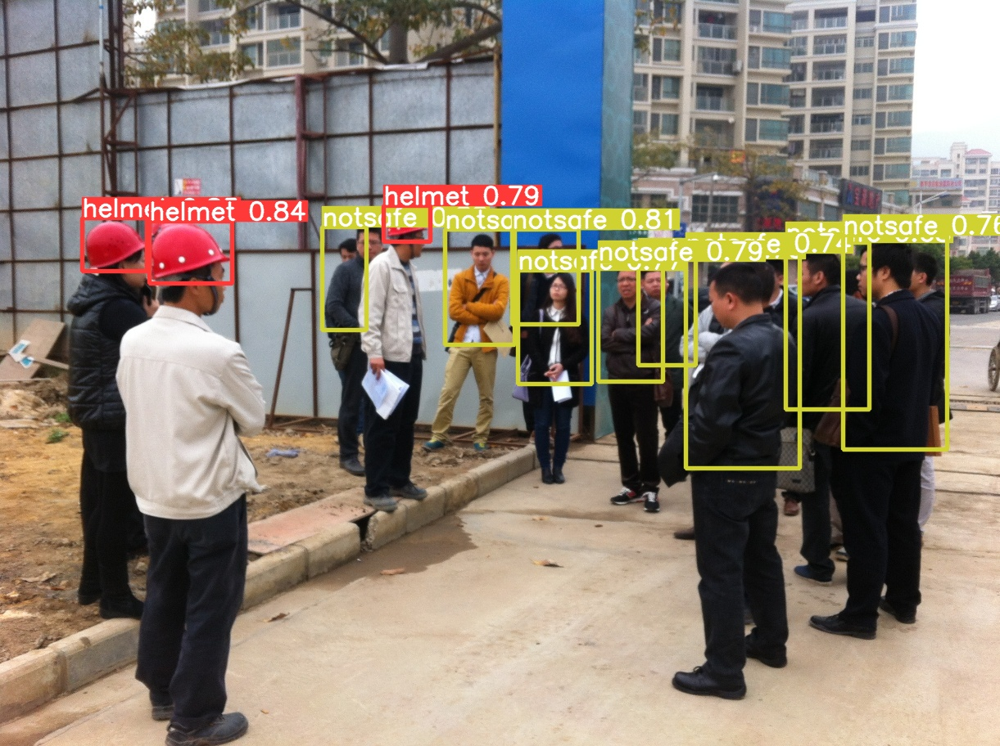

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(4387).jpg', width=1000)


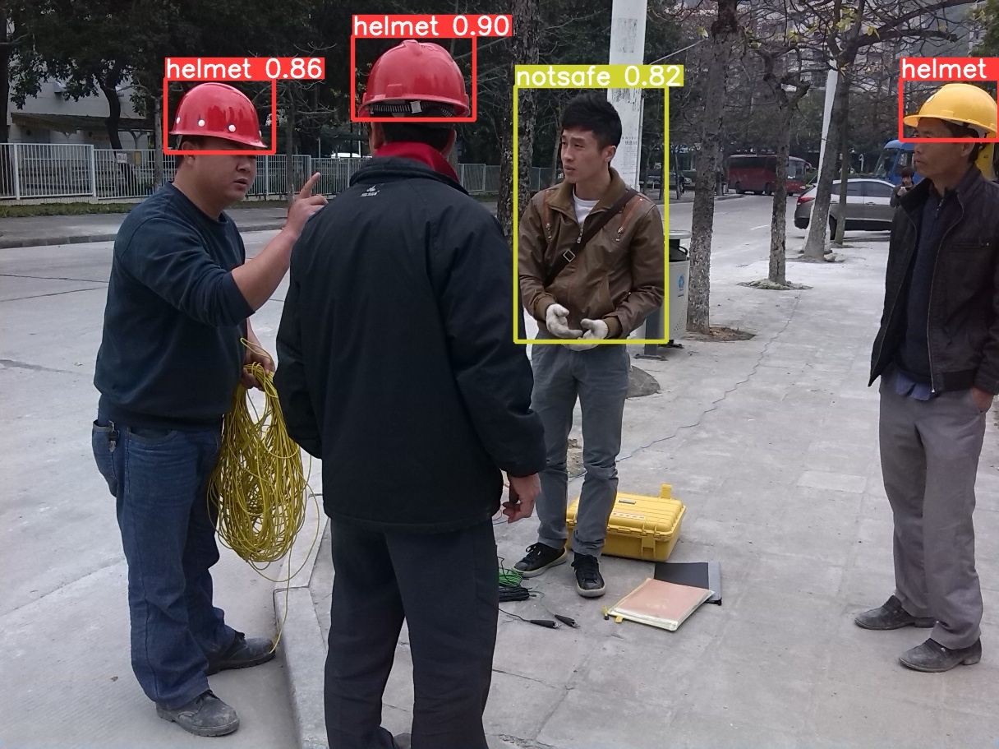

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(743).jpg', width=1000)


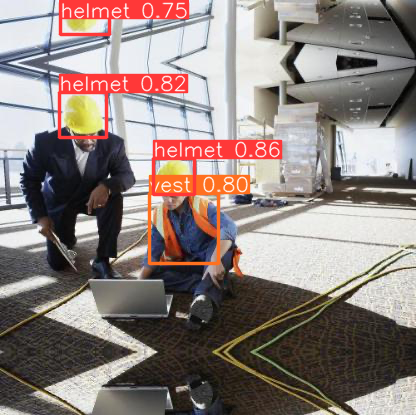

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers4876.png', width=1000)

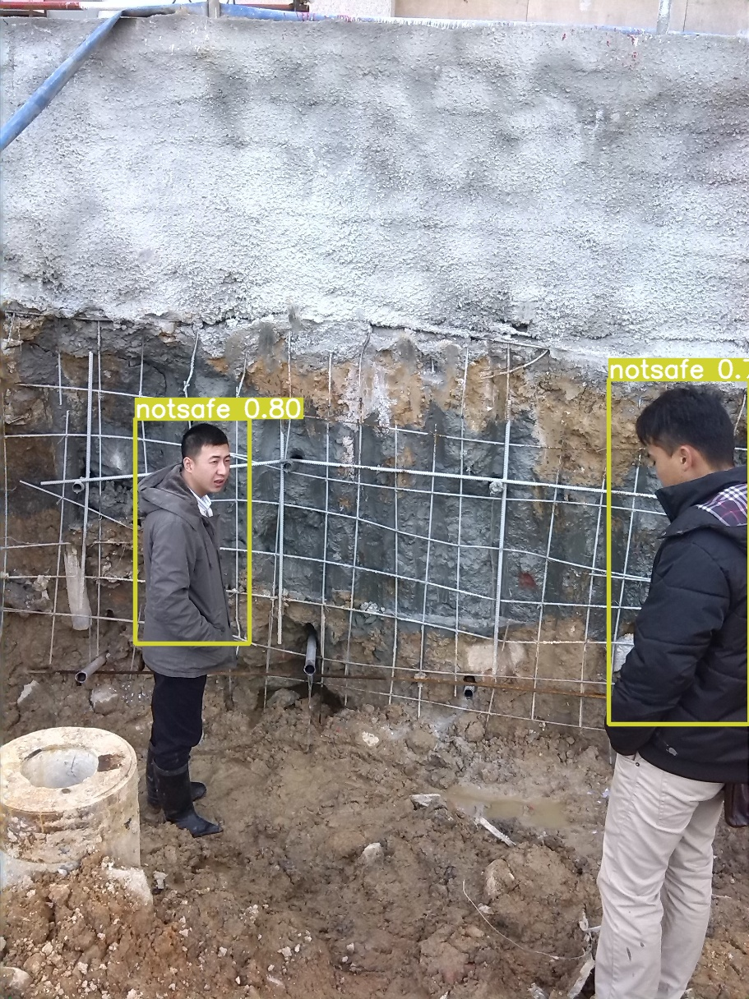

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(354).jpg', width=1000)


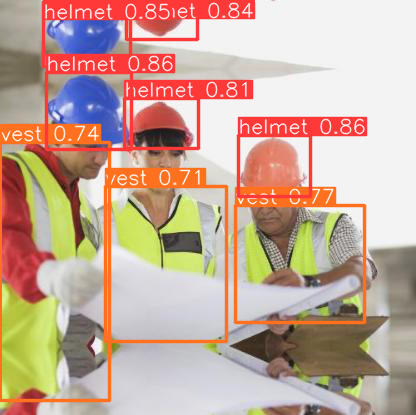

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers4820.png', width=1000)

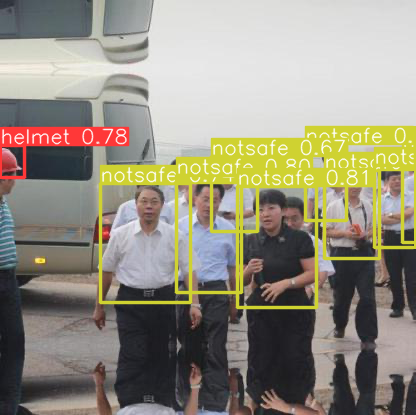

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/hard_hat_workers4783.png', width=1000)

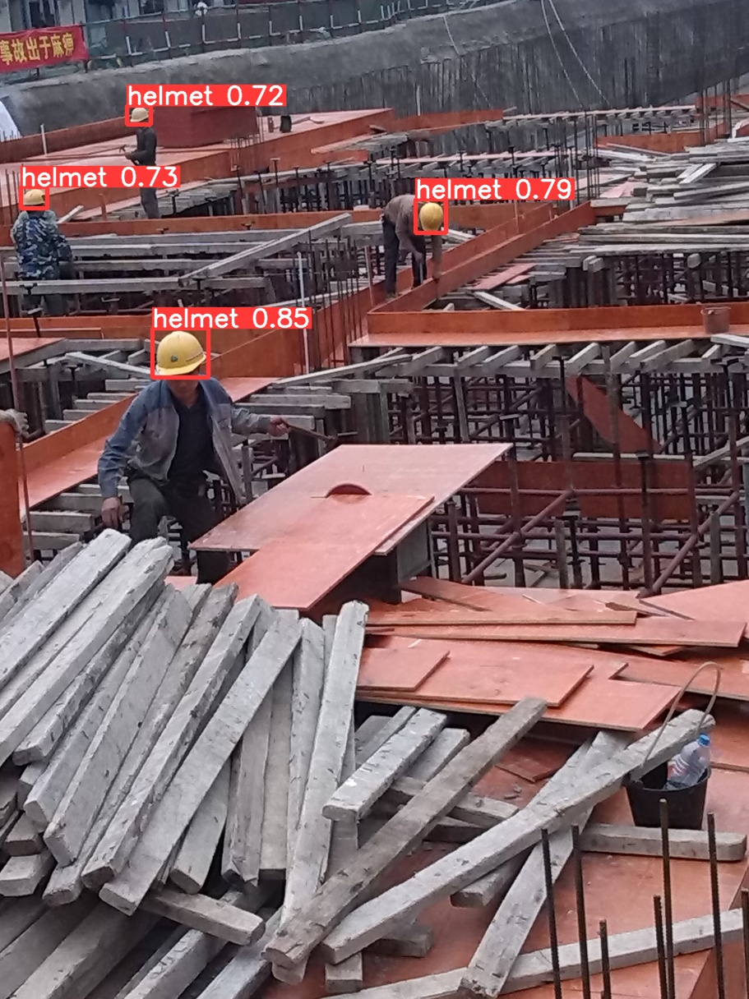

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/image_from_china(751).jpg', width=1000)


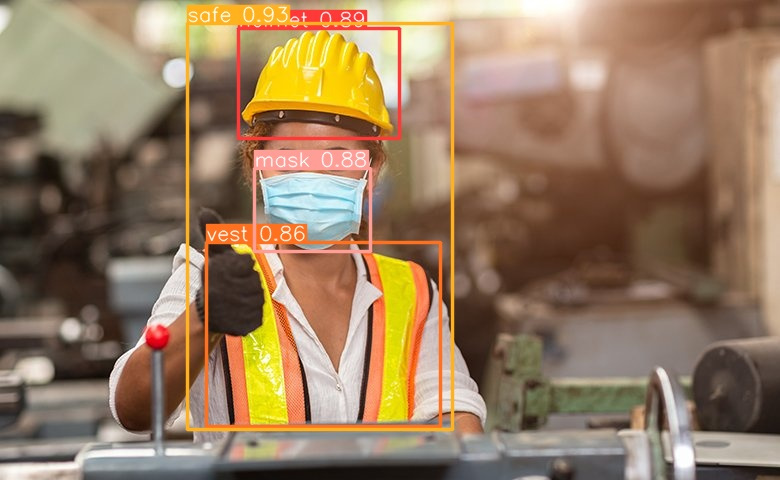

In [ ]:


from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/108.jpg', width=1000)


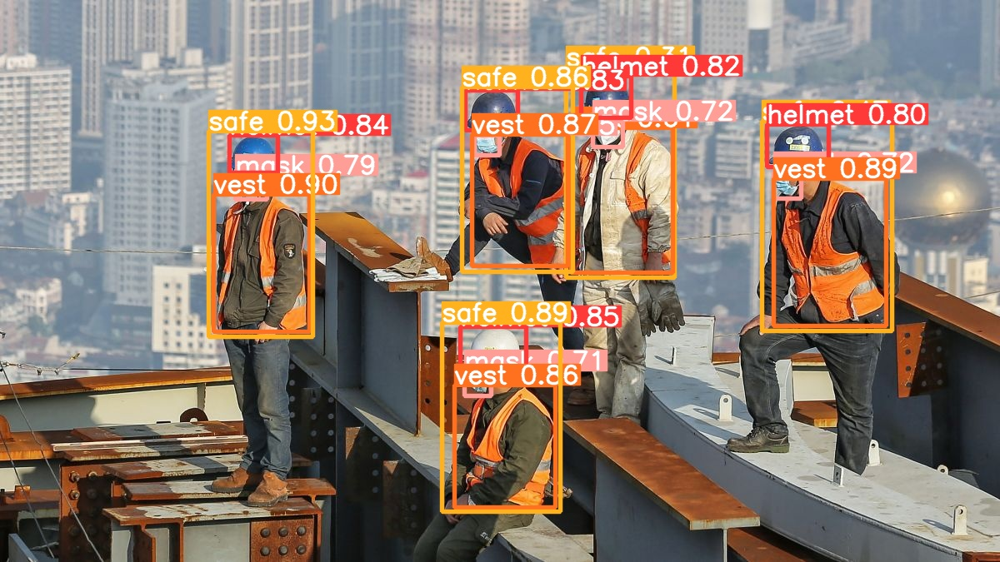

In [ ]:
from IPython.display import Image #this is to render predictions
Image(filename='/content/drive/MyDrive/Construction_site_v6/YOLOv6/runs/inference/exp/98.jpg', width=1000)
